In [3]:
# Loading the Packages
%reload_ext autoreload
%autoreload 2

# basic packages
import warnings
warnings.filterwarnings('ignore')
import os
import sys
from pathlib import Path
from tqdm import tqdm

# data processing packages
import numpy as np
import pandas as pd
import scanpy as sc
import squidpy as sq
from collections import defaultdict
from glmpca import glmpca
from itertools import combinations
import math

# gaston related packages
import torch
from importlib import reload
import gaston
from gaston import neural_net,cluster_plotting, dp_related, segmented_fit, restrict_spots, model_selection
from gaston import binning_and_plotting, isodepth_scaling, run_slurm_scripts, parse_adata
from gaston import spatial_gene_classification, plot_cell_types, filter_genes, process_NN_output

# visualization packages
import seaborn as sns
import matplotlib.pyplot as plt
plt.rcParams.update({
    "pgf.texsystem": "xelatex",      # 使用 XeLaTeX，如果不需要 LaTeX 公式渲染，可以省略
    'font.family': 'serif',          # 字体设置为衬线字体
    'text.usetex': False,            # 禁用 LaTeX，使用 Matplotlib 内置文字渲染
    'pgf.rcfonts': False,            # 禁用 pgf 的默认字体管理
    'pdf.fonttype': 42,              # 确保字体为 TrueType 格式，可被 Illustrator 编辑
    'ps.fonttype': 42,               # EPS 文件也使用 TrueType 格式
    'figure.dpi': 300,               # 设置图形分辨率
    'savefig.dpi': 300,              # 保存的图形文件分辨率
    'axes.unicode_minus': False,     # 避免负号问题
})

In [42]:
if torch.cuda.is_available(): torch.set_default_device('cuda')
else: torch.set_default_device('cpu')
print("Default device:", torch.tensor([1.0]).device)

Default device: cuda:0


In [4]:
# workdir 
BASE_DIR = Path(r'G:\spatial_data\processed')
RUN_ID = '20230523_HCC_PRISM_probe_refined'
src_dir = BASE_DIR / f'{RUN_ID}_processed'

# Load one slide exp
base_path = BASE_DIR / f'{RUN_ID}_processed'
data_path = base_path / "segmented"
typ_path = base_path / "cell_typing"
output_path = base_path / "GASTON"
output_path.mkdir(exist_ok=True)

## preprocess

In [5]:
# Load the data
combine_adata_st = sc.read_h5ad(typ_path / 'combine_adata_st.h5ad')
adata_direct = sc.read_h5ad(typ_path / 'adata_leiden_res_1.h5ad')
adata = adata_direct[adata_direct.obs.index.isin(combine_adata_st.obs.index)]
adata.obs = combine_adata_st.obs

# format for later analysis
adata.obs = adata.obs.rename(columns={'X_pos':'X', 'Y_pos':'Y'})
adata.obsm['spatial'] = adata.obs.loc[:, ['X', 'Y']].values
adata.obs['batch'] = adata.obs['dataset']
adata = adata[adata.obs['type'] != 'other']
print(adata)
adata.obs.head()

View of AnnData object with n_obs × n_vars = 60329 × 31
    obs: 'dataset', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'type', 'leiden', 'sample', 'tissue', 'tmp_leiden', 'leiden_subtype', 'subtype', 'leiden_type', 'Y', 'X', 'batch'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'mean', 'std'
    uns: 'leiden', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'


,dataset,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,n_genes,n_counts,type,leiden,sample,tissue,tmp_leiden,leiden_subtype,subtype,leiden_type,Y,X,batch
0,PRISM_HCC,9,2.302585,22.0,3.135494,9,22.0,Macrophage,0,NaN,non_liver,0,18,Macrophage_LYVE1+,11,1109,21214,PRISM_HCC
2,PRISM_HCC,10,2.397895,16.0,2.833213,10,16.0,Mast,13,NaN,non_liver,13,12,Mast_CPA3+,8,1156,21143,PRISM_HCC
4,PRISM_HCC,6,1.945910,7.0,2.079442,6,7.0,CD4+,28,NaN,non_liver,28,23,"T_CD4+, PD1+, CTLA4+",12,1164,21132,PRISM_HCC
5,PRISM_HCC,13,2.639057,41.0,3.737670,13,41.0,CD8+,45,NaN,non_liver,45,28,"T_CD8+, GZMA+, CXCL13+",13,1177,11828,PRISM_HCC
6,PRISM_HCC,10,2.397895,18.0,2.944439,10,18.0,Macrophage,0,NaN,non_liver,0,18,Macrophage_LYVE1+,11,1179,21227,PRISM_HCC


In [ ]:
counts_mat = np.array(adata.raw.X)
coords_mat = adata.obsm['spatial']
cell_types = adata.obs.subtype.values
gene_labels = np.array(adata.var.index)

## run GLM-PCA

In [10]:
# GLM-PCA parameters
num_dims=20
penalty=1

# CHANGE THESE PARAMETERS TO REDUCE RUNTIME
num_iters=30
eps=1e-4
num_genes=10000

counts_mat_glmpca=counts_mat[:,np.argsort(np.sum(counts_mat, axis=0))[-num_genes:]]
glmpca_res=glmpca.glmpca(counts_mat_glmpca.T, num_dims, fam="poi", penalty=penalty, verbose=True,
                        ctl = {"maxIter":num_iters, "eps":eps, "optimizeTheta":True})
A = glmpca_res['factors'] # should be of size N x num_dims, where each column is a PC

np.save(output_path / 'glmpca.npy', A)

Iteration: 0 | deviance=2.4750E+6
Iteration: 1 | deviance=2.4750E+6
Iteration: 2 | deviance=1.2318E+6
Iteration: 3 | deviance=7.4298E+5
Iteration: 4 | deviance=5.3416E+5
Iteration: 5 | deviance=4.2338E+5
Iteration: 6 | deviance=3.5505E+5
Iteration: 7 | deviance=3.0873E+5
Iteration: 8 | deviance=2.7537E+5
Iteration: 9 | deviance=2.5044E+5
Iteration: 10 | deviance=2.3130E+5
Iteration: 11 | deviance=2.1625E+5
Iteration: 12 | deviance=2.0416E+5
Iteration: 13 | deviance=1.9423E+5
Iteration: 14 | deviance=1.8594E+5
Iteration: 15 | deviance=1.7889E+5
Iteration: 16 | deviance=1.7283E+5
Iteration: 17 | deviance=1.6755E+5
Iteration: 18 | deviance=1.6290E+5
Iteration: 19 | deviance=1.5876E+5
Iteration: 20 | deviance=1.5506E+5
Iteration: 21 | deviance=1.5172E+5
Iteration: 22 | deviance=1.4868E+5
Iteration: 23 | deviance=1.4591E+5
Iteration: 24 | deviance=1.4337E+5
Iteration: 25 | deviance=1.4103E+5
Iteration: 26 | deviance=1.3886E+5
Iteration: 27 | deviance=1.3684E+5
Iteration: 28 | deviance=1.349

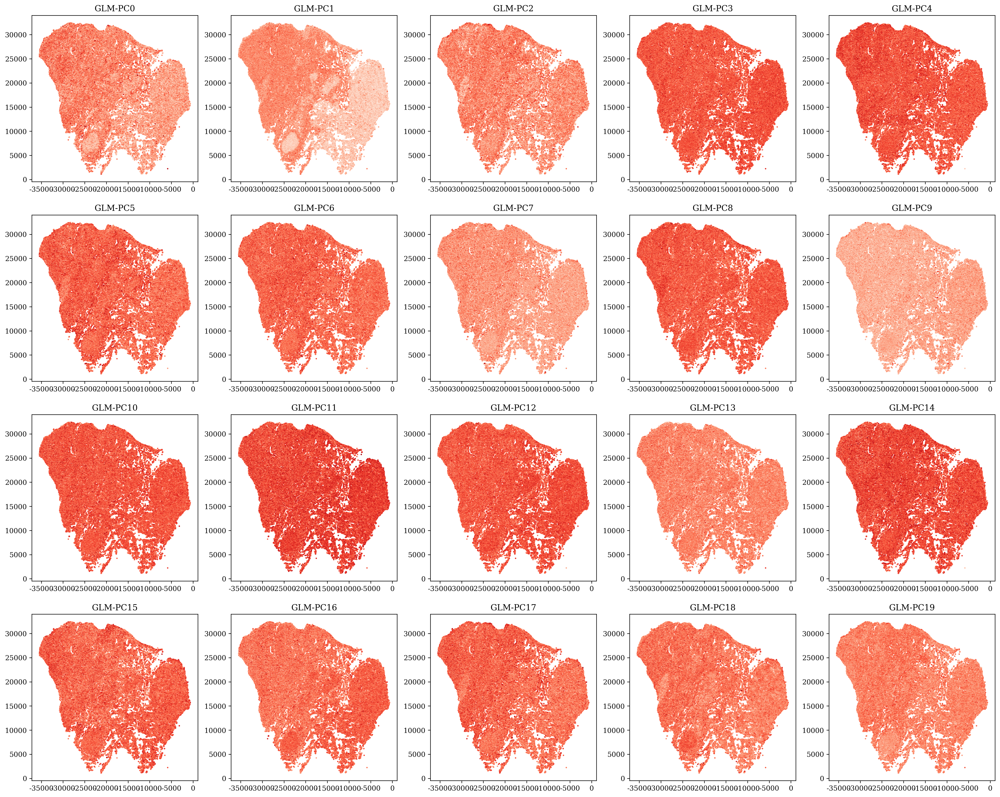

In [106]:
# visualize top GLM-PCs
R=4
C=5
fig,axs=plt.subplots(R,C,figsize=(C*5, R*5))
for r in range(R):
    for c in range(C):
        i=r*C+c
        axs[r,c].scatter(-1*coords_mat[:,0], coords_mat[:,1], c=A[:,i],cmap='Reds',s=1)
        axs[r,c].set_title(f'GLM-PC{i}')
plt.show()

In [12]:
xmin, xmax = np.min(coords_mat[:,0]), np.max(coords_mat[:,0])
ymin, ymax = np.min(coords_mat[:,1]), np.max(coords_mat[:,1])

pts_bounded=np.where( (coords_mat[:,0] >= xmin) & (coords_mat[:,0] <= xmax) & 
                     (coords_mat[:,1] >= ymin) & (coords_mat[:,1] <= ymax) )[0]

counts_mat_bounded=counts_mat[pts_bounded,:]
coords_mat_bounded=coords_mat[pts_bounded,:]
pcs_bounded=A[pts_bounded,:]
cell_types_bounded=cell_types[pts_bounded]

np.save(output_path / 'coords_mat_bounded.npy', coords_mat_bounded)
np.save(output_path / 'glmpca_bounded.npy', pcs_bounded)
np.save(output_path / 'cell_labels_bounded.npy', cell_types_bounded)
np.save(output_path / 'counts_mat_bounded.npy', counts_mat[pts_bounded,:])
np.save(output_path / 'gene_labels.npy', gene_labels)

## Train GASTON network

In [43]:
# Load data generated above
path_to_coords=output_path / 'coords_mat_bounded.npy'
path_to_glmpca=output_path / 'glmpca_bounded.npy'

A=np.load(path_to_glmpca)
S=np.load(path_to_coords)

# z-score normalize S and A
S_torch, A_torch = neural_net.load_rescale_input_data(S,A)

In [ ]:
# # Move data to GPU
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# S_torch = S_torch.to(device)
# A_torch = A_torch.to(device)

In [ ]:
###################################### 
# NEURAL NET PARAMETERS (USER CAN CHANGE)
# architectures are encoded as list, eg [20,20] means two hidden layers of size 20 hidden neurons
isodepth_arch = [20, 20]  # architecture for isodepth neural network d(x,y) : R^2 -> R 
expression_fn_arch = [20, 20]  # architecture for 1-D expression function h(w) : R -> R^G

num_epochs = 200000  # number of epochs to train NN (NOTE: it is sometimes beneficial to train longer)
checkpoint = 500  # save model after number of epochs = multiple of checkpoint
out_dir = output_path / 'HCC_gaston_model'  # folder to save model runs
optimizer = "adam"
num_restarts = 30

######################################

seed_list = range(num_restarts)
for seed in seed_list:
    print(f'training neural network for seed {seed}')
    out_dir_seed = f"{out_dir}/rep{seed}"
    os.makedirs(out_dir_seed, exist_ok=True)
    
    # Move model to GPU
    mod, loss_list = neural_net.train(S_torch, A_torch,
                                      S_hidden_list=isodepth_arch, A_hidden_list=expression_fn_arch, 
                                      epochs=num_epochs, checkpoint=checkpoint, 
                                      save_dir=out_dir_seed, optim=optimizer, seed=seed, save_final=True)
    

## process GASTON output

In [50]:
gaston_model, A, S= process_NN_output.process_files(output_path / 'HCC_gaston_model') # model trained above
gaston_model


best model: G:\spatial_data\processed\20230523_HCC_PRISM_probe_refined_processed\GASTON\HCC_gaston_model\rep4


GASTON(
  (spatial_embedding): Sequential(
    (0): Linear(in_features=2, out_features=20, bias=True)
    (1): ReLU()
    (2): Linear(in_features=20, out_features=20, bias=True)
    (3): ReLU()
    (4): Linear(in_features=20, out_features=1, bias=True)
  )
  (expression_function): Sequential(
    (0): Linear(in_features=1, out_features=20, bias=True)
    (1): ReLU()
    (2): Linear(in_features=20, out_features=20, bias=True)
    (3): ReLU()
    (4): Linear(in_features=20, out_features=20, bias=True)
  )
)

In [51]:
# May need to re-load data
counts_mat=np.load(output_path / 'counts_mat_bounded.npy', allow_pickle=True)
coords_mat=np.load(output_path / 'coords_mat_bounded.npy', allow_pickle=True)
gene_labels=np.load(output_path / 'gene_labels.npy', allow_pickle=True)
cell_labels_bounded=np.load(output_path / 'cell_labels_bounded.npy', allow_pickle=True)

Kneedle number of domains: 6


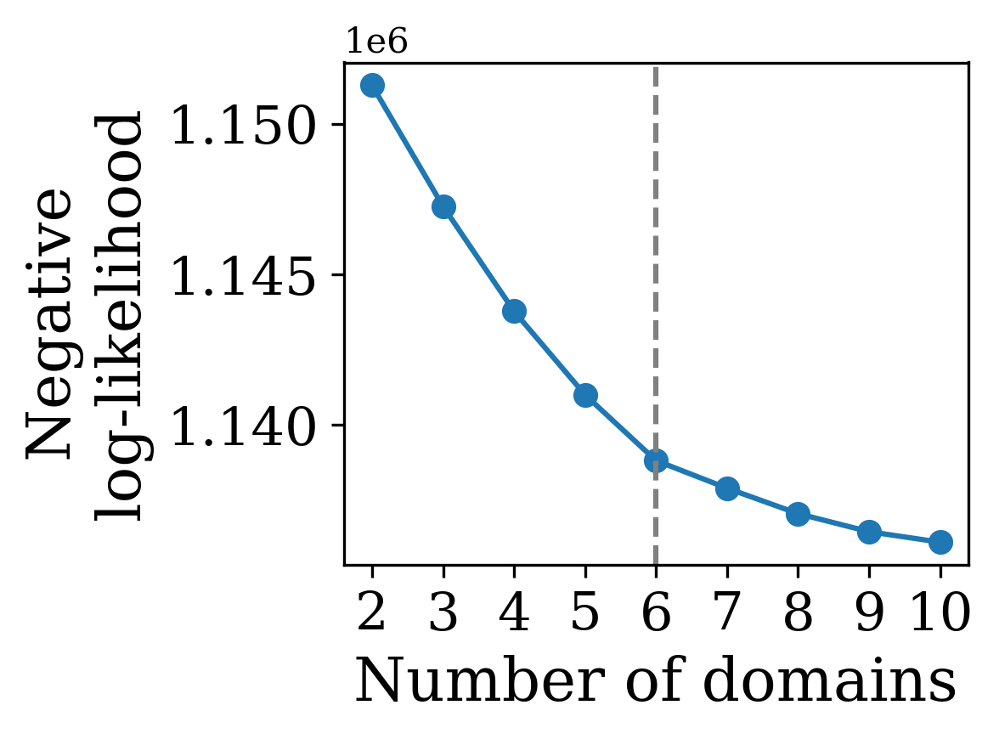

In [53]:
model_selection.plot_ll_curve(gaston_model, A, S, max_domain_num=10, start_from=2)

In [58]:
num_layers = 6 # CHANGE FOR YOUR APPLICATION (use number of layers from above)
gaston_isodepth, gaston_labels = dp_related.get_isodepth_labels(gaston_model, A, S, num_layers)

# # DATASET-SPECIFIC: so domains are ordered outer to inner
# gaston_isodepth = np.max(gaston_isodepth) - gaston_isodepth
# gaston_labels = (num_layers-1)-gaston_labels

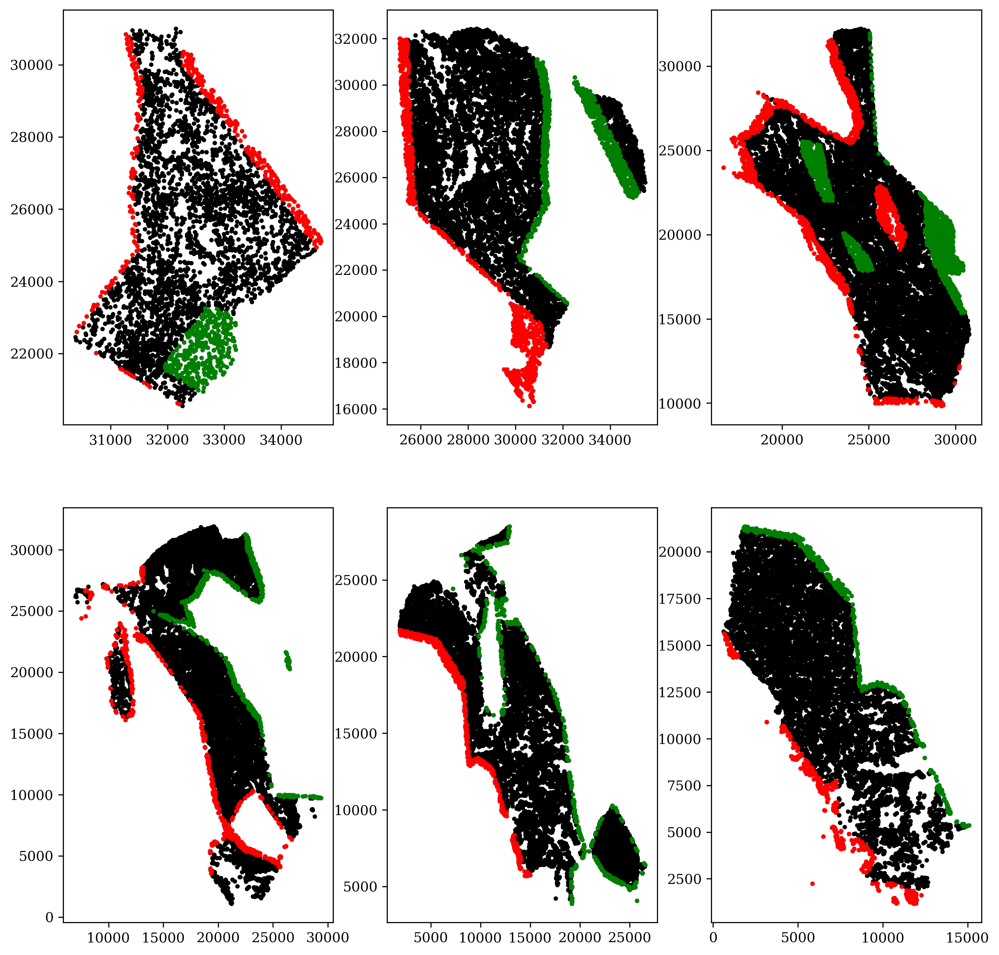

In [62]:
# WITH VISUALIZATION
gaston_isodepth, scaling_factors = isodepth_scaling.adjust_isodepth(gaston_isodepth, gaston_labels, coords_mat, num_domains=num_layers,
                                                                    q_vals=[0.1, 0.1, 0.1, 0.05, 0.05, 0.05], scale_factor=0.1625, visualize=True, figsize=(12, 12), num_rows=2,
                                                                    return_scaling_factors=True)

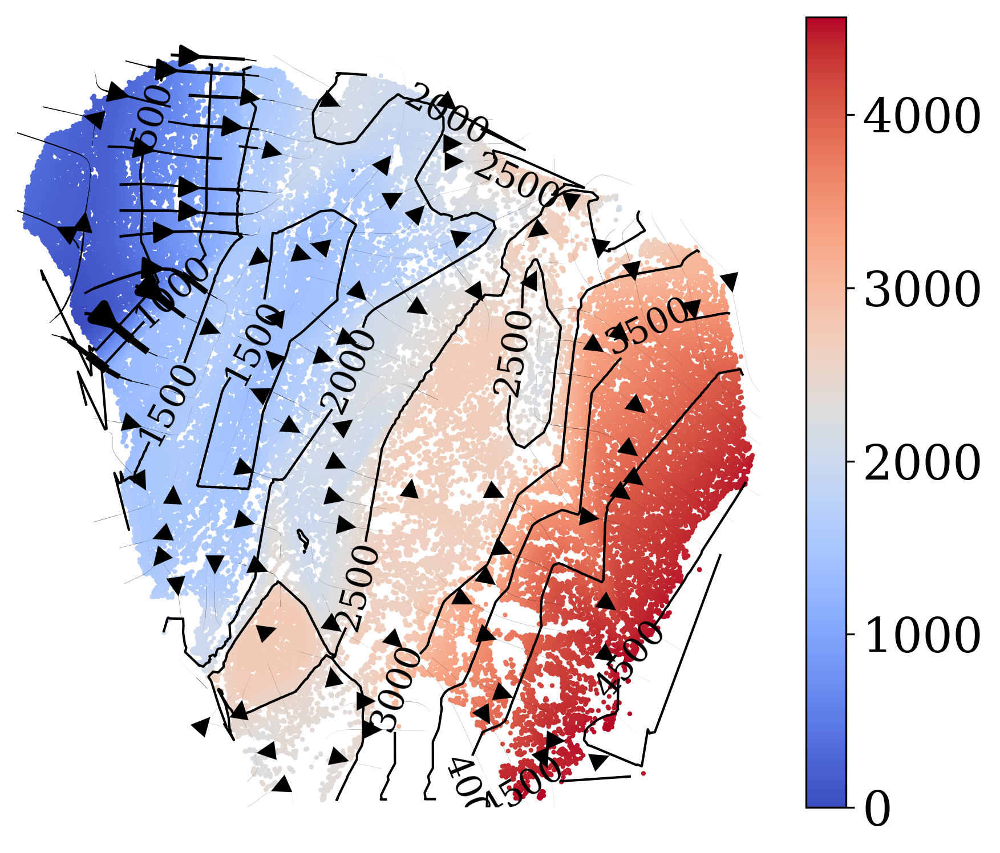

In [ ]:
show_streamlines=True

linear_transform=np.array([[-1,0], [0,1]]) # reflect points across x axis
cluster_plotting.plot_isodepth(gaston_isodepth, S, gaston_model, 
                               figsize=(7,6), streamlines=show_streamlines, s=1,
                               scaling_factors=scaling_factors,
                               gaston_labels_for_scaling=gaston_labels,
                               streamlines_lw=2, contour_levels=10, 
                               cbar_fs=20, contour_fs=15,
                               linear_transform=linear_transform)

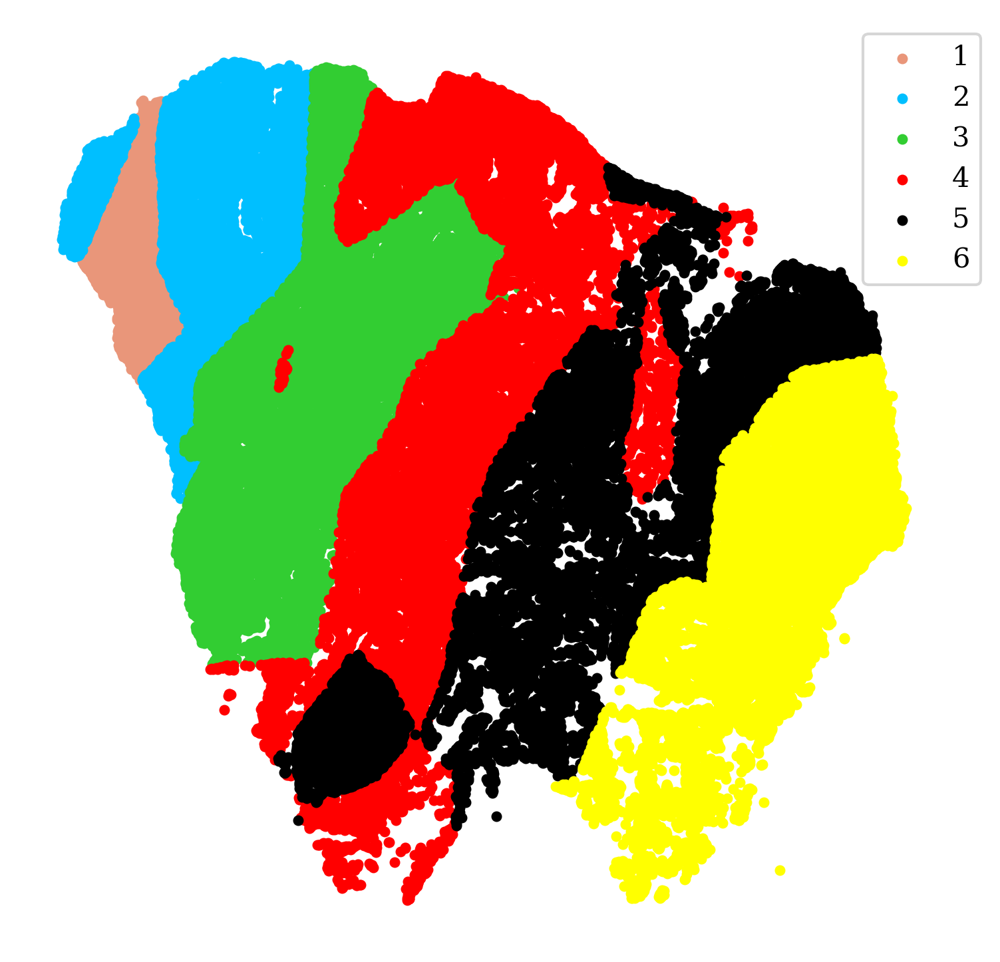

In [70]:
layer_colors=['darksalmon', 'deepskyblue', 'limegreen', 'red', 'black', 'yellow']
labels=[1,2,3,4,5,6]

cluster_plotting.plot_clusters(gaston_labels, S, figsize=(6, 6), colors=layer_colors, 
                               s=8, lgd=True, labels=labels,
                              bbox_to_anchor=(1.05,1),linear_transform=linear_transform)

## cell types vs isodepth

Number of unique domains: 6
(13, 60) ['Liver', 'Neutrophil', 'B', 'Ep', 'CD8+', 'Tumor', 'other_cell_proliferation', 'Macrophage', 'CAF', 'Monocyte', 'DC', 'CD4+', 'Mait']


Text(0, 0.5, 'Cell type proportion')

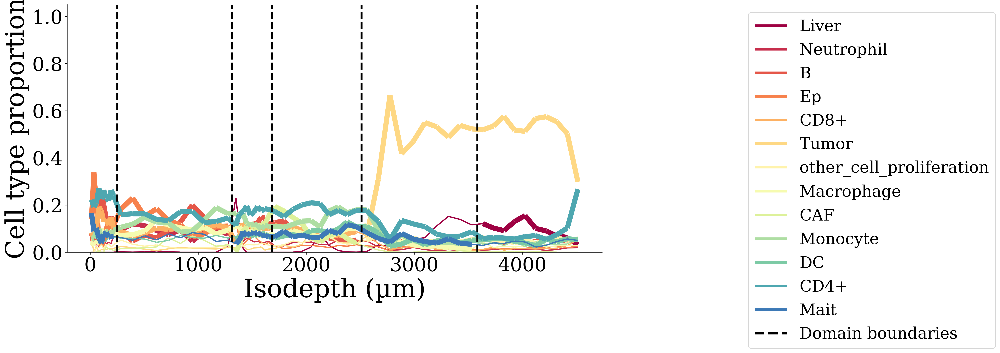

In [88]:
cell_type_df = process_NN_output.create_cell_type_df(adata.obs.type)

# Check the number of unique domains
num_domains = len(np.unique(gaston_labels))
print(f"Number of unique domains: {num_domains}")

# Ensure num_bins_per_domain has the correct number of elements
# num_bins_per_domain = [7, 10, 7, 7, 10, 10]  # Example for 4 domains

# If num_domains is dynamic, use this instead:
num_bins_per_domain = [10] * num_domains  # Default value for all domains

# Plot cell type proportions
plot_cell_types.plot_ct_props(
    cell_type_df, gaston_labels, gaston_isodepth, 
    num_bins_per_domain=num_bins_per_domain, ct_colors=None,
    include_lgd=True, figsize=(15, 7), ticksize=30, width1=8, width2=2, 
    domain_ct_threshold=0.7
)

# Add labels
plt.xlabel('Isodepth (µm)', fontsize=40)
plt.ylabel('Cell type proportion', fontsize=40)

## spatially varying gene analysis

In [92]:
# Cell types for which to compute cell type-specific expression functions.
# ct_list=[] # USE THIS EITHER: (1) for speed if you don't care about cell type specific effects or (2) you don't have cell type dict
ct_list=plot_cell_types.domain_cts_svg(cell_type_df, gaston_labels, gaston_isodepth, domain_ct_threshold=0.7, num_bins_per_domain=[10]*num_domains)

print(f'Cell types to compute expression functions for: {ct_list}')

# if you want to get rid of warnings
import warnings
warnings.filterwarnings("ignore")

# Piecewise linear fit parameters
t=0.1 # set slope=0 if LLR p-value > 0.1
umi_threshold=500 # only compute fit for genes with total UMI > 500
zero_fit_threshold=0 # xenium is not sparse so can compute for all cell types

pw_fit_dict=segmented_fit.pw_linear_fit(counts_mat, gaston_labels, gaston_isodepth, 
                                          cell_type_df, ct_list, zero_fit_threshold=zero_fit_threshold,
                                        t=t,umi_threshold=umi_threshold,
                                       isodepth_mult_factor=0.1) # isodepth_mult_factor for stability, if range of isodepth values is too large

Cell types to compute expression functions for: ['B' 'CAF' 'CD4+' 'CD8+' 'DC' 'Ep' 'Liver' 'Macrophage' 'Mait' 'Monocyte'
 'Neutrophil' 'Tumor' 'other_cell_proliferation']
Poisson regression for ALL cell types


100%|██████████| 31/31 [00:01<00:00, 20.08it/s]


Poisson regression for cell type: B


100%|██████████| 31/31 [00:00<00:00, 42.80it/s]


Poisson regression for cell type: CAF


100%|██████████| 31/31 [00:00<00:00, 54.65it/s]


Poisson regression for cell type: CD4+


100%|██████████| 31/31 [00:00<00:00, 36.60it/s]


Poisson regression for cell type: CD8+


100%|██████████| 31/31 [00:00<00:00, 44.54it/s]


Poisson regression for cell type: DC


100%|██████████| 31/31 [00:00<00:00, 45.83it/s]


Poisson regression for cell type: Ep


100%|██████████| 31/31 [00:00<00:00, 45.67it/s]


Poisson regression for cell type: Liver


100%|██████████| 31/31 [00:00<00:00, 50.12it/s]


Poisson regression for cell type: Macrophage


100%|██████████| 31/31 [00:00<00:00, 44.81it/s]


Poisson regression for cell type: Mait


100%|██████████| 31/31 [00:00<00:00, 44.44it/s]


Poisson regression for cell type: Monocyte


100%|██████████| 31/31 [00:00<00:00, 42.14it/s]


Poisson regression for cell type: Neutrophil


100%|██████████| 31/31 [00:00<00:00, 41.63it/s]


Poisson regression for cell type: Tumor


100%|██████████| 31/31 [00:00<00:00, 36.08it/s]


Poisson regression for cell type: other_cell_proliferation


100%|██████████| 31/31 [00:00<00:00, 42.16it/s]


In [94]:
print(f"counts_mat shape: {counts_mat.shape}")
print(f"gaston_labels shape: {gaston_labels.shape}")
print(f"cell_type_df shape: {cell_type_df.shape}")
print(f"gene_labels shape: {gene_labels.shape}")

counts_mat shape: (60329, 31)
gaston_labels shape: (60329,)
cell_type_df shape: (60329, 17)
gene_labels shape: (31,)


In [95]:
binning_output=binning_and_plotting.bin_data(
    counts_mat, gaston_labels, gaston_isodepth, 
    cell_type_df, gene_labels, num_bins_per_domain=[10]*num_domains, umi_threshold=umi_threshold)
domain_cts=plot_cell_types.get_domain_cts(binning_output, 0.7)

In [96]:
discont_genes_layer=spatial_gene_classification.get_discont_genes(pw_fit_dict, binning_output)
cont_genes_layer=spatial_gene_classification.get_cont_genes(pw_fit_dict, binning_output, q=0.9)
cont_genes_ct=spatial_gene_classification.get_cont_genes(pw_fit_dict, binning_output, ct_attributable=True, domain_cts=domain_cts,q=0.9)
cont_genes_ct

{'HBV': [(1, 'CD4+'),
  (1, 'Ep'),
  (1, 'CD8+'),
  (1, 'Macrophage'),
  (2, 'CD4+'),
  (2, 'Monocyte'),
  (2, 'B'),
  (2, 'CAF'),
  (2, 'CD8+'),
  (2, 'Macrophage'),
  (2, 'Mait'),
  (2, 'DC'),
  (4, 'Tumor'),
  (4, 'CD4+'),
  (4, 'Monocyte'),
  (4, 'DC'),
  (4, 'Macrophage'),
  (4, 'Mait')],
 'EPCAM': [(1, 'CD4+'), (1, 'CD8+'), (1, 'Neutrophil'), (5, 'CD4+')],
 'ACTA2': [(3, 'CD4+'),
  (3, 'Monocyte'),
  (3, 'DC'),
  (3, 'CD8+'),
  (3, 'Mait'),
  (3, 'Macrophage'),
  (3, 'B')],
 'CD1C': [(0, 'B'),
  (0, 'CD8+'),
  (0, 'Ep'),
  (0, 'Mait'),
  (2, 'CD4+'),
  (2, 'B'),
  (2, 'CD8+'),
  (2, 'Macrophage'),
  (2, 'DC'),
  (3, 'CAF'),
  (3, 'Mait'),
  (3, 'Macrophage')],
 'CPA3': [(5, 'Other')],
 'C1QA': [(4, 'CD4+'), (4, 'DC'), (4, 'Mait')],
 'CSF3R': [(1, 'CD4+'), (1, 'CD8+')],
 'LYVE1': [(4, 'Tumor')],
 'CXCL13': [(5, 'CD4+')],
 'CD79A': [(3, 'CAF'), (3, 'Mait'), (3, 'Macrophage')],
 'MS4A1': [(0, 'Macrophage'), (0, 'Mait')],
 'MZB1': [(0, 'Mait'),
  (2, 'CD4+'),
  (2, 'Monocyte'),
  (2,

In [97]:
domain_cts

{0: array(['CD4+', 'B', 'CD8+', 'Ep', 'Monocyte', 'Macrophage', 'Mait'],
       dtype='<U24'),
 1: array(['CD4+', 'Ep', 'Monocyte', 'B', 'CD8+', 'Macrophage', 'Neutrophil'],
       dtype='<U24'),
 2: array(['CD4+', 'Monocyte', 'B', 'CAF', 'CD8+', 'Macrophage', 'Mait', 'DC'],
       dtype='<U24'),
 3: array(['CD4+', 'Monocyte', 'CAF', 'DC', 'CD8+', 'Mait', 'Macrophage', 'B'],
       dtype='<U24'),
 4: array(['Tumor', 'CD4+', 'Monocyte', 'DC', 'Macrophage',
        'other_cell_proliferation', 'Mait'], dtype='<U24'),
 5: array(['Tumor', 'Liver', 'CD4+', 'other_cell_proliferation', 'DC'],
       dtype='<U24')}

gene HBV, continuous gradients [(1, 'CD4+'), (1, 'Ep'), (1, 'CD8+'), (1, 'Macrophage'), (2, 'CD4+'), (2, 'Monocyte'), (2, 'B'), (2, 'CAF'), (2, 'CD8+'), (2, 'Macrophage'), (2, 'Mait'), (2, 'DC'), (4, 'Tumor'), (4, 'CD4+'), (4, 'Monocyte'), (4, 'DC'), (4, 'Macrophage'), (4, 'Mait')]


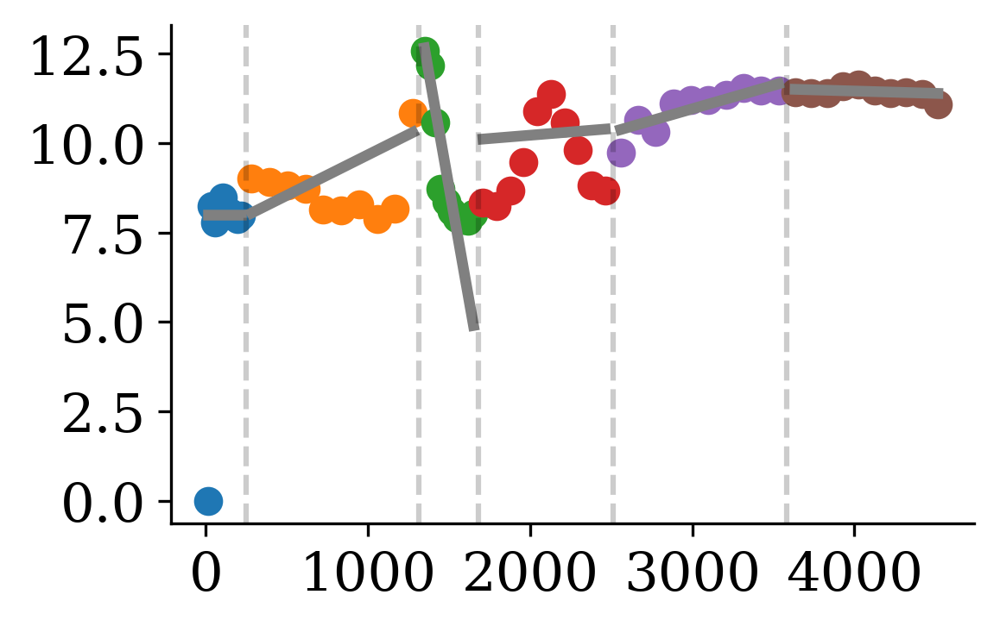

In [99]:
gene_name='HBV'
print(f'gene {gene_name}, continuous gradients {cont_genes_ct[gene_name]}')

binning_and_plotting.plot_gene_pwlinear(gene_name, pw_fit_dict, gaston_labels, gaston_isodepth, 
                                        binning_output, cell_type_list=None, pt_size=50, colors=None, 
                                        linear_fit=True, ticksize=15, figsize=(4,2.5), offset=10**6, lw=3,
                                       domain_boundary_plotting=True)
# plt.ylim((1.5,8.5))

Text(0.5, 1.0, 'CD4+ Monocyte B CAF CD8+ Macrophage Mait DC only')

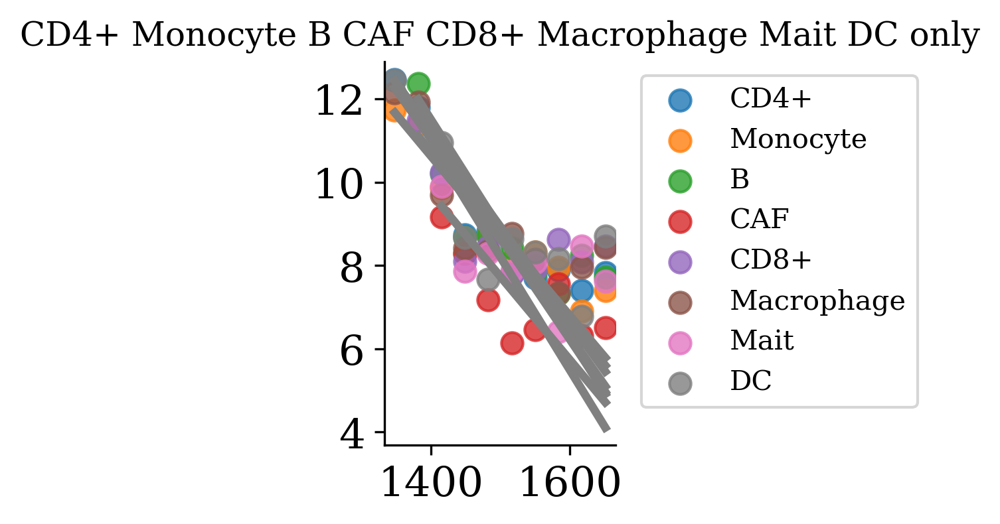

In [104]:
# show cell type-specific functions in domain 1 (granule)
domain=2
cts=domain_cts[domain]
#remove stromal
# cts=[x for x in cts if x != 'Tumor']

binning_and_plotting.plot_gene_pwlinear(gene_name, pw_fit_dict, gaston_labels, gaston_isodepth, binning_output,
                                        cell_type_list=cts,ct_colors=None, spot_threshold=0.05, pt_size=60, 
                                        colors=None, linear_fit=True, domain_list=[domain],ticksize=15, 
                                        figsize=(1.5,2.5), offset=10**6, lw=3, alpha=0.8,show_lgd=True)
cts_list=' '.join(map(str, cts))
plt.title(f'{cts_list} only')